# Semantic Segmentation
## Project GOAL : Detect Road from KITTI dataset
- Data Download link : http://www.cvlibs.net/datasets/kitti/eval_semantics.php  
- Segment the road

# Set up and Check Environment

In [1]:
import os
import math
import numpy as np
import tensorflow as tf

from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

In [2]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [3]:
!nvidia-smi

Sun Nov 19 16:20:31 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.182.03   Driver Version: 470.182.03   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   59C    P8    10W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# 1. Data
## 1.1 Data Loader

In [4]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

# Train Dataset -> return Randomly HorizontalFlip or Crop & Resized image
# Test Dataset -> return Resized image
def build_augmentation(is_train=True):
    if is_train:
        return Compose([
            HorizontalFlip(p=0.5),   
                    RandomSizedCrop(        
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              
                        width=224,
                        height=224
                        )
                    ])
    return Compose([ 
                Resize(
                    width=224,
                    height=224
                    )
                ])

In [5]:
def DL_build_augmentation(is_train=True):
    if is_train:
        return Compose([
            HorizontalFlip(p=0.5),   
                    RandomSizedCrop(        
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              
                        width=448,
                        height=448
                        )
                    ])
    return Compose([ 
                Resize(
                    width=448,
                    height=448
                    )
                ])

In [6]:
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))


DLaugmentation_train = DL_build_augmentation()
DLaugmentation_test = DL_build_augmentation(is_train=False)

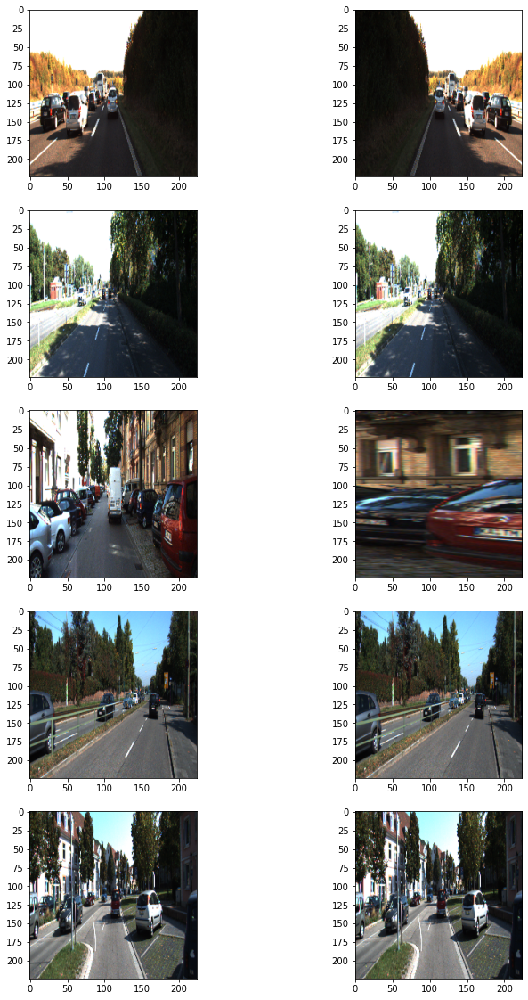

In [8]:
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i])
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"]) 
plt.show()

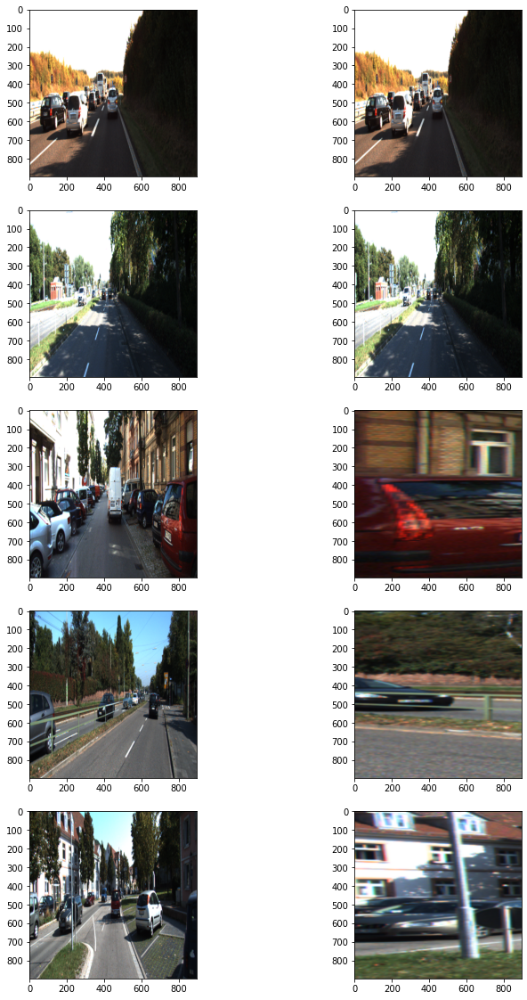

In [9]:
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i])
    image_data = {"image":image}
    resized = DLaugmentation_test(**image_data)
    processed = DLaugmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"]) 
plt.show()

In [7]:
class KittiGenerator(tf.keras.utils.Sequence):
    def __init__(self, 
               dir_path,
               batch_size=8,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.is_train = is_train
        self.dir_path = dir_path
        self.augmentation = augmentation
        self.img_size = img_size
        self.output_size = output_size
        
        self.data = self.load_dataset()
        
    # Load Dataset 
    # Number of Validation dataset or Test dataset = 30
    def load_dataset(self):
        input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
        label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
        
        input_images.sort()
        label_images.sort()
        
        assert len(input_images) == len(label_images)
        
        data = [_ for _ in zip (input_images, label_images)]
        
        if self.is_train:
            return data[:-30]
        return data[-30:]
    
    # Retrieve Data length
    def __len__(self):
        return math.ceil(len(self.data) / self.batch_size)
    
    
    # Retrieve one batch augmented item set
    def __getitem__(self, index):
        batch_data = self.data[
            index*self.batch_size:
            (index + 1)*self.batch_size
        ]
        
        # setup dimensions
        inputs = np.zeros([self.batch_size, *self.img_size])
        outputs = np.zeros([self.batch_size, *self.output_size])
        
        for i, data in enumerate(batch_data):
            input_img_path, output_path = data
            _input = imread(input_img_path)
            _output = imread(output_path)
            _output = (_output==7).astype(np.uint8)*1
            data = {
              "image": _input,
              "mask": _output,
            }
            augmented = self.augmentation(**data)
            
            # Convert input image pixels value to 0~1
            # Because augmented["mask"] value consists of 0 value or 1 value
            inputs[i] = augmented["image"]/255
            outputs[i] = augmented["mask"]
        return inputs, outputs
    
    # Randomly shuffle the dataset
    def on_epoch_end(self):
        self.indexes = np.arange(len(self.data))
        if self.is_train == True :
            np.random.shuffle(self.indexes)
        return self.indexes

In [8]:
class DL_KittiGenerator(tf.keras.utils.Sequence):
    def __init__(self, 
               dir_path,
               batch_size=4,
               img_size=(448, 448, 3),
               output_size=(448, 448),
               is_train=True,
               augmentation=None):
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.is_train = is_train
        self.dir_path = dir_path
        self.augmentation = augmentation
        self.img_size = img_size
        self.output_size = output_size
        
        self.data = self.load_dataset()
        
    # Load Dataset 
    # Number of Validation dataset or Test dataset = 30
    def load_dataset(self):
        input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
        label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
        
        input_images.sort()
        label_images.sort()
        
        assert len(input_images) == len(label_images)
        
        data = [_ for _ in zip (input_images, label_images)]
        
        if self.is_train:
            return data[:-30]
        return data[-30:]
    
    # Retrieve Data length
    def __len__(self):
        return math.ceil(len(self.data) / self.batch_size)
    
    
    # Retrieve one batch augmented item set
    def __getitem__(self, index):
        batch_data = self.data[
            index*self.batch_size:
            (index + 1)*self.batch_size
        ]
        
        # setup dimensions
        inputs = np.zeros([self.batch_size, *self.img_size])
        outputs = np.zeros([self.batch_size, *self.output_size])
        
        for i, data in enumerate(batch_data):
            input_img_path, output_path = data
            _input = imread(input_img_path)
            _output = imread(output_path)
            _output = (_output==7).astype(np.uint8)*1
            data = {
              "image": _input,
              "mask": _output,
            }
            augmented = self.augmentation(**data)
            
            # Convert input image pixels value to 0~1
            # Because augmented["mask"] value consists of 0 value or 1 value
            inputs[i] = augmented["image"]/255
            outputs[i] = augmented["mask"]
        return inputs, outputs
    
    # Randomly shuffle the dataset
    def on_epoch_end(self):
        self.indexes = np.arange(len(self.data))
        if self.is_train == True :
            np.random.shuffle(self.indexes)
        return self.indexes

In [9]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

In [10]:
DLaugmentation = DL_build_augmentation()
DLtest_preproc = DL_build_augmentation(is_train=False)
        
DL_train_generator = DL_KittiGenerator(
    dir_path, 
    augmentation=DLaugmentation,
)

DL_test_generator = DL_KittiGenerator(
    dir_path, 
    augmentation=DLtest_preproc,
    is_train=False
)

# 2. Model
## 2.1 Build Model
- own_model : UNet  
- Nested_UNet: UNet ++  

## UNet

In [11]:
from tensorflow import keras
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Conv2DTranspose, Add, GlobalAveragePooling2D
from tensorflow.keras.layers import Activation, BatchNormalization, Concatenate, SeparableConv2D, UpSampling2D
from tensorflow.keras.layers import Input, Conv2D

In [18]:
def conv_block_for_UNet(inputs, filter_size):
    x = Conv2D(filter_size, 3, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(filter_size, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    return x

In [19]:
def build_UNet_model(input_shape=(224, 224, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    for i in range(4):
        filter_size = min_filter_size * (2**i)
        x = conv_block_for_UNet(x, filter_size)
        encode_blocks.append(x)
        x = MaxPooling2D((2,2))(x)

    # Middle
    x = conv_block_for_UNet(x, 1024)
    
    # Decoder
    for i in range(4):
        filter_size = max_filter_size * (2**(-i))
        x = Conv2DTranspose(filter_size, (2,2), strides=2, padding='same')(x)
        x = Concatenate()([x, encode_blocks[3-i]])
        x = conv_block_for_UNet(x , filter_size)
    
    x = Conv2D(2, 3, padding='same')(x)
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(x)
    
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [12]:
own_model = build_UNet_model()
own_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 224, 224, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 224, 224, 64) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

## UNet++

In [20]:
def create_nest_block(nest_blocks, index):
    layers = [64, 128, 256, 512]
    nest_block = []

    last_index = len(nest_blocks[index]) - 1
    for i in range(0, last_index):
        up = Conv2DTranspose(layers[i], (2, 2), strides=2, padding='same')(nest_blocks[index][i + 1])
        print(f"{index}-th upshape: {up.shape}")
        
        concat = up  # Initialize concat with the up tensor
        for j in range(index + 1):
            concat = Concatenate()([concat, nest_blocks[j][i]])
        concat = conv_block_for_UNet(concat, up.shape[-1])
        nest_block.append(concat)
        
        print(f"{index}-th concat: {concat.shape}")
    nest_blocks.append(nest_block)


In [21]:
def build_Nested_UNet_model(input_shape=(224, 224, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    for i in range(5):
        filter_size = min_filter_size * (2**i)
        x = conv_block_for_UNet(x, filter_size)
        if i != 4:
            encode_blocks.append(x)
            x = MaxPooling2D((2,2))(x)
        else:
            encode_blocks.append(x)
        
            
    nest_blocks = []
    nest_blocks.append(encode_blocks)
    
    # Nest Calculate
    for i in range(4):
        create_nest_block(nest_blocks, i)
    
    print(nest_blocks[4])
    x = Conv2D(2, 3, padding='same')(nest_blocks[4][0])
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(x)
    
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [22]:
Nested_UNet = build_Nested_UNet_model()
Nested_UNet.summary()

0-th upshape: (None, 224, 224, 64)
0-th concat: (None, 224, 224, 64)
0-th upshape: (None, 112, 112, 128)
0-th concat: (None, 112, 112, 128)
0-th upshape: (None, 56, 56, 256)
0-th concat: (None, 56, 56, 256)
0-th upshape: (None, 28, 28, 512)
0-th concat: (None, 28, 28, 512)
1-th upshape: (None, 224, 224, 64)
1-th concat: (None, 224, 224, 64)
1-th upshape: (None, 112, 112, 128)
1-th concat: (None, 112, 112, 128)
1-th upshape: (None, 56, 56, 256)
1-th concat: (None, 56, 56, 256)
2-th upshape: (None, 224, 224, 64)
2-th concat: (None, 224, 224, 64)
2-th upshape: (None, 112, 112, 128)
2-th concat: (None, 112, 112, 128)
3-th upshape: (None, 224, 224, 64)
3-th concat: (None, 224, 224, 64)
[<KerasTensor: shape=(None, 224, 224, 64) dtype=float32 (created by layer 'activation_29')>]
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
inpu

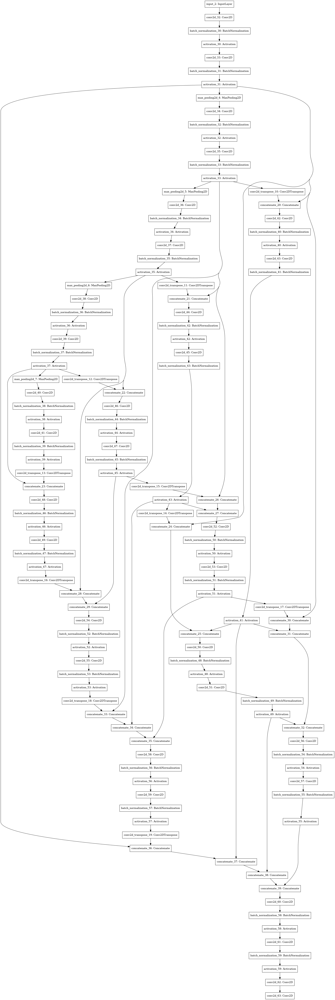

In [15]:
from tensorflow.keras.utils import plot_model


plot_model(Nested_UNet, to_file='./model_UNet++.png')

## DeepLab v3 +

In [16]:
def entry_flow_block(inputs):
    x = Conv2D(32, 3, strides=2, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(64, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    layer_list = [128, 256, 728]
    
    for i in range(3):
        residual = x 
        residual = Conv2D(layer_list[i], 1, strides=2, padding='same')(residual)
        
        if i != 0:
            x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
        x = Add()([x, residual])
    return x
    
def middle_flow_block(inputs):
    residual = inputs
    x = inputs
    
    for i in range(3):
        x = Activation('relu')(x)
        x = SeparableConv2D(728, 3, padding='same')(x)
        x = BatchNormalization()(x)
    
    x = Add()([x, residual])
    
    return x
    
def exit_flow_block(inputs):
    residual = inputs
    x = inputs
    residual = Conv2D(1024, 1, strides=2, padding='same')(residual)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(728, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(1024, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = Add()([x, residual])
    
    x = SeparableConv2D(1536, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    x = SeparableConv2D(2048, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    return x

In [17]:
def ASPP(inputs):
    
    conv_1 = SeparableConv2D(2048, 1)(inputs)
    conv_1 = BatchNormalization()(conv_1)
    conv_1 = Activation('relu')(conv_1)
    
    conv_6 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=6)(inputs)
    conv_6 = BatchNormalization()(conv_6)
    conv_6 = Activation('relu')(conv_6)
    
    conv_12 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=12)(inputs)
    conv_12 = BatchNormalization()(conv_12)
    conv_12 = Activation('relu')(conv_12)
    
    conv_18 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=18)(inputs)
    conv_18 = BatchNormalization()(conv_18)
    conv_18 = Activation('relu')(conv_18)
    
    img_pooling = MaxPooling2D((2,2))(inputs)
    img_pooling = Conv2D(2048, 1, padding='same')(img_pooling)
    img_pooling = BatchNormalization()(img_pooling)
    img_pooling = Activation('relu')(img_pooling)
    img_pooling = UpSampling2D(size=(2, 2), interpolation='bilinear')(img_pooling)
    
    outputs = Concatenate()([conv_1, conv_6, conv_12, conv_18, img_pooling])
    outputs = Conv2D(512, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs)
    return outputs

In [21]:
def build_DLV3Plus_model(input_shape=(448, 448, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    # Entry Flow
    x = entry_flow_block(inputs)
    # Middle Flow
    for i in range(8):
        x = middle_flow_block(x)
    # Exit Flow
    exit_1 = exit_flow_block(x) # 14, 14, 2048 -> output stride: 32
    exit_2 = ASPP(exit_1) ## 56, 56, 512
    
    # Decoder
    exit_1 = Conv2D(512, 1, padding='same')(exit_1)
    print(exit_1.shape)
    exit_1 = UpSampling2D(size=(4, 4), interpolation='bilinear')(exit_1)
    outputs = Concatenate()([exit_1, exit_2])
    
    outputs = Conv2DTranspose(64, (3, 3), strides=2, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs)
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(outputs)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [22]:
DLV3_plus = build_DLV3Plus_model()
DLV3_plus.summary()

(None, 14, 14, 512)
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 448, 448, 3) 0                                            
__________________________________________________________________________________________________
conv2d_10 (Conv2D)              (None, 224, 224, 32) 896         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_41 (BatchNo (None, 224, 224, 32) 128         conv2d_10[0][0]                  
__________________________________________________________________________________________________
activation_40 (Activation)      (None, 224, 224, 32) 0           batch_normalization_41[0][0]     
________________________________________________________________________

## Modified DeepLab v3 +

In [47]:
def modified_entry_flow_block(inputs):
    x = Conv2D(32, 3, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(64, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    layer_list = [128, 256, 728]
    
    for i in range(3):
        residual = x 
        residual = Conv2D(layer_list[i], 1, strides=2, padding='same')(residual)
        
        if i != 0:
            x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
        x = Add()([x, residual])
    return x
    
def modified_middle_flow_block(inputs):
    residual = inputs
    x = inputs
    
    for i in range(3):
        x = Activation('relu')(x)
        x = SeparableConv2D(728, 3, padding='same')(x)
        x = BatchNormalization()(x)
    
    x = Add()([x, residual])
    
    return x
    
def modified_exit_flow_block(inputs):
    residual = inputs
    x = inputs
    residual = Conv2D(1024, 1, strides=2, padding='same')(residual)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(728, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(1024, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = Add()([x, residual])
    
    x = SeparableConv2D(1536, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    x = SeparableConv2D(2048, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    return x

In [12]:
def modified_ASPP(inputs):
    
    conv_1 = SeparableConv2D(2048, 1)(inputs)
    conv_1 = BatchNormalization()(conv_1)
    conv_1 = Activation('relu')(conv_1)
    
    conv_6 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=6)(inputs)
    conv_6 = BatchNormalization()(conv_6)
    conv_6 = Activation('relu')(conv_6)
    
    conv_12 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=12)(inputs)
    conv_12 = BatchNormalization()(conv_12)
    conv_12 = Activation('relu')(conv_12)
    
    conv_18 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=18)(inputs)
    conv_18 = BatchNormalization()(conv_18)
    conv_18 = Activation('relu')(conv_18)
    
    img_pooling = MaxPooling2D((2,2))(inputs)
    img_pooling = Conv2D(2048, 1, padding='same')(img_pooling)
    img_pooling = BatchNormalization()(img_pooling)
    img_pooling = Activation('relu')(img_pooling)
    img_pooling = UpSampling2D(size=(2, 2), interpolation='bilinear')(img_pooling)
    
    outputs = Concatenate()([conv_1, conv_6, conv_12, conv_18, img_pooling])
    outputs = Conv2D(512, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(2, 2), interpolation='bilinear')(outputs)
    return outputs

In [49]:
def build_Modified_DLV3Plus_model(input_shape=(448, 448, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    # Entry Flow
    x = modified_entry_flow_block(inputs)
    # Middle Flow
    for i in range(8):
        x = modified_middle_flow_block(x)
    # Exit Flow
    output_1 = modified_exit_flow_block(x) # 28, 28, 2048 | Output strides = 16
    output_1 = Conv2D(48, 1, padding='same')(output_1) # 28, 28, 48
    output_1 = Conv2DTranspose(48, (3, 3), strides=4, padding='same')(output_1) # 112, 112, 48
    output_2 = modified_ASPP(x) # 112, 112, 512 
    
    outputs = Concatenate()([output_1, output_2])
    outputs = Conv2DTranspose(64, (3, 3), strides=4, padding='same')(outputs) #448, 448, 64
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(outputs)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [18]:
Modified_DLV3_plus = build_Modified_DLV3Plus_model()
Modified_DLV3_plus.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 448, 448, 3) 0                                            
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 448, 448, 32) 896         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_82 (BatchNo (None, 448, 448, 32) 128         conv2d_20[0][0]                  
__________________________________________________________________________________________________
activation_80 (Activation)      (None, 448, 448, 32) 0           batch_normalization_82[0][0]     
______________________________________________________________________________________________

## Additionaly Modified DeepLab v3 +
### Change Decoder only (Conv2D transpose -> Up sampling

In [13]:
def additionaly_modified_entry_flow_block(inputs):
    x = Conv2D(32, 3, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(64, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    layer_list = [128, 256, 728]
    
    for i in range(3):
        residual = x 
        residual = Conv2D(layer_list[i], 1, strides=2, padding='same')(residual)
        
        if i != 0:
            x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
        x = Add()([x, residual])
    return x
    
def additionaly_modified_middle_flow_block(inputs):
    residual = inputs
    x = inputs
    
    for i in range(3):
        x = Activation('relu')(x)
        x = SeparableConv2D(728, 3, padding='same')(x)
        x = BatchNormalization()(x)
    
    x = Add()([x, residual])
    
    return x
    
def additionaly_modified_exit_flow_block(inputs):
    residual = inputs
    x = inputs
    residual = Conv2D(1024, 1, strides=2, padding='same')(residual)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(728, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(1024, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = Add()([x, residual])
    
    x = SeparableConv2D(1536, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    x = SeparableConv2D(2048, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    return x

In [14]:
def additionaly_modified_ASPP(inputs):
    
    conv_1 = SeparableConv2D(2048, 1)(inputs)
    conv_1 = BatchNormalization()(conv_1)
    conv_1 = Activation('relu')(conv_1)
    
    conv_6 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=6)(inputs)
    conv_6 = BatchNormalization()(conv_6)
    conv_6 = Activation('relu')(conv_6)
    
    conv_12 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=12)(inputs)
    conv_12 = BatchNormalization()(conv_12)
    conv_12 = Activation('relu')(conv_12)
    
    conv_18 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=18)(inputs)
    conv_18 = BatchNormalization()(conv_18)
    conv_18 = Activation('relu')(conv_18)
    
    img_pooling = MaxPooling2D((2,2))(inputs)
    img_pooling = Conv2D(2048, 1, padding='same')(img_pooling)
    img_pooling = BatchNormalization()(img_pooling)
    img_pooling = Activation('relu')(img_pooling)
    img_pooling = UpSampling2D(size=(2, 2), interpolation='bilinear')(img_pooling)
    
    outputs = Concatenate()([conv_1, conv_6, conv_12, conv_18, img_pooling])
    outputs = Conv2D(256, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(2, 2), interpolation='bilinear')(outputs)
    return outputs

In [15]:
def additionaly_build_Modified_DLV3Plus_model(input_shape=(448, 448, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    # Entry Flow
    x = additionaly_modified_entry_flow_block(inputs)
    # Middle Flow
    for i in range(8):
        x = additionaly_modified_middle_flow_block(x)
    # Exit Flow
    output_1 = additionaly_modified_exit_flow_block(x) # 28, 28, 2048 | Output strides = 16
    output_1 = Conv2D(48, 1, padding='same')(output_1) # 28, 28, 48
    output_1 = UpSampling2D(size=(4, 4), interpolation='bilinear')(output_1) # 112, 112, 48
    output_2 = additionaly_modified_ASPP(x) # 112, 112, 256
   
    outputs = Concatenate()([output_1, output_2])
    outputs = Conv2D(64, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs) #448, 448, 64
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(outputs)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [18]:
Additionaly_Modified_DLV3_plus = additionaly_build_Modified_DLV3Plus_model()
Additionaly_Modified_DLV3_plus.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 448, 448, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 448, 448, 32) 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 448, 448, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 448, 448, 32) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

# Final Test - Testing Dependancy of Feature map size

In [42]:
def final_modified_entry_flow_block(inputs):
    x = Conv2D(32, 3, strides=2, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(64, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    layer_list = [128, 256, 728]
    
    for i in range(3):
        residual = x 
        residual = Conv2D(layer_list[i], 1, strides=2, padding='same')(residual)
        
        if i != 0:
            x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
        x = Add()([x, residual])
    return x
    
def final_modified_middle_flow_block(inputs):
    residual = inputs
    x = inputs
    
    for i in range(3):
        x = Activation('relu')(x)
        x = SeparableConv2D(728, 3, padding='same')(x)
        x = BatchNormalization()(x)
    
    x = Add()([x, residual])
    
    return x
    
def final_modified_exit_flow_block(inputs):
    residual = inputs
    x = inputs
    residual = Conv2D(1024, 1, strides=2, padding='same')(residual)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(728, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(1024, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = Add()([x, residual])
    
    x = SeparableConv2D(1536, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    x = SeparableConv2D(2048, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    return x

In [68]:
def final_modified_ASPP(inputs):
    
    conv_1 = SeparableConv2D(2048, 1)(inputs)
    conv_1 = BatchNormalization()(conv_1)
    conv_1 = Activation('relu')(conv_1)
    
    conv_6 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=6)(inputs)
    conv_6 = BatchNormalization()(conv_6)
    conv_6 = Activation('relu')(conv_6)
    
    conv_12 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=12)(inputs)
    conv_12 = BatchNormalization()(conv_12)
    conv_12 = Activation('relu')(conv_12)
    
    conv_18 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=18)(inputs)
    conv_18 = BatchNormalization()(conv_18)
    conv_18 = Activation('relu')(conv_18)
    
    img_pooling = MaxPooling2D((2,2))(inputs)
    img_pooling = Conv2D(2048, 1, padding='same')(img_pooling)
    img_pooling = BatchNormalization()(img_pooling)
    img_pooling = Activation('relu')(img_pooling)
    img_pooling = UpSampling2D(size=(2, 2), interpolation='bilinear')(img_pooling)
    
    outputs = Concatenate()([conv_1, conv_6, conv_12, conv_18, img_pooling])
    outputs = Conv2D(256, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs)
    return outputs

In [69]:
def final_build_Modified_DLV3Plus_model(input_shape=(448, 448, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    # Entry Flow
    x = final_modified_entry_flow_block(inputs)
    # Middle Flow
    for i in range(8):
        x = final_modified_middle_flow_block(x)
    # Exit Flow
    output_1 = final_modified_exit_flow_block(x) # 14, 14, 2048 | Output strides = 32
    print(output_1.shape)
    output_1 = Conv2D(48, 1, padding='same')(output_1) # 14, 14, 48
    output_1 = UpSampling2D(size=(8, 8), interpolation='bilinear')(output_1) # 112, 112, 48
    output_2 = final_modified_ASPP(x)  # 112, 112, 256
    print(output_2.shape)
    
    outputs = Concatenate()([output_1, output_2])
    outputs = Conv2D(64, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs) #448, 448, 64
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(outputs)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [70]:
Final_Modified_DLV3_plus = final_build_Modified_DLV3Plus_model()
Final_Modified_DLV3_plus.summary()

(None, 14, 14, 2048)
(None, 112, 112, 256)
Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 448, 448, 3) 0                                            
__________________________________________________________________________________________________
conv2d_98 (Conv2D)              (None, 224, 224, 32) 896         input_11[0][0]                   
__________________________________________________________________________________________________
batch_normalization_410 (BatchN (None, 224, 224, 32) 128         conv2d_98[0][0]                  
__________________________________________________________________________________________________
activation_400 (Activation)     (None, 224, 224, 32) 0           batch_normalization_410[0][0]    
_________________________________________________

## REAL DEEPLABv3+

In [100]:
def REAL_entry_flow_block(inputs):
    x = Conv2D(32, 3, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(64, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    layer_list = [128, 256, 728]
    
    for i in range(3):
        residual = x 
        residual = Conv2D(layer_list[i], 1, strides=2, padding='same')(residual)
        
        if i != 0:
            x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = SeparableConv2D(layer_list[i], 3, padding='same')(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
        x = Add()([x, residual])
    return x
    
def REAL_middle_flow_block(inputs):
    residual = inputs
    x = inputs
    
    for i in range(3):
        x = Activation('relu')(x)
        x = SeparableConv2D(728, 3, padding='same')(x)
        x = BatchNormalization()(x)
    
    x = Add()([x, residual])
    
    return x
    
def REAL_exit_flow_block(inputs):
    residual = inputs
    x = inputs
    residual = Conv2D(1024, 1, strides=2, padding='same')(residual)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(728, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = Activation('relu')(x)
    x = SeparableConv2D(1024, 3, padding='same')(x)
    x = BatchNormalization()(x)
    
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = Add()([x, residual])
    
    
    x = SeparableConv2D(1536, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    x = SeparableConv2D(2048, 3, padding='same')(x)
    x = BatchNormalization()(x) 
    x = Activation('relu')(x)
    
    return x

In [109]:
def REAL_ASPP(inputs):
    
    conv_1 = SeparableConv2D(2048, 1)(inputs)
    conv_1 = BatchNormalization()(conv_1)
    conv_1 = Activation('relu')(conv_1)
    
    conv_6 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=6)(inputs)
    conv_6 = BatchNormalization()(conv_6)
    conv_6 = Activation('relu')(conv_6)
    
    conv_12 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=12)(inputs)
    conv_12 = BatchNormalization()(conv_12)
    conv_12 = Activation('relu')(conv_12)
    
    conv_18 = SeparableConv2D(2048, 3, strides=1, padding='same', dilation_rate=18)(inputs)
    conv_18 = BatchNormalization()(conv_18)
    conv_18 = Activation('relu')(conv_18)
    
    img_pooling = MaxPooling2D((2,2))(inputs)
    img_pooling = Conv2D(2048, 1, padding='same')(img_pooling)
    img_pooling = BatchNormalization()(img_pooling)
    img_pooling = Activation('relu')(img_pooling)
    img_pooling = UpSampling2D(size=(2, 2), interpolation='bilinear')(img_pooling)
    
    outputs = Concatenate()([conv_1, conv_6, conv_12, conv_18, img_pooling])
    outputs = Conv2D(256, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs)
    return outputs

In [112]:
def build_REAL_DLV3Plus_model(input_shape=(448, 448, 3)):
    min_filter_size = 64
    max_filter_size = 512
    
    encode_blocks = []
    
    inputs = tf.keras.layers.Input(shape=input_shape)
    x = inputs
    
    # Encoder
    # Entry Flow
    x = REAL_entry_flow_block(inputs)
    # Middle Flow
    for i in range(8):
        x = REAL_middle_flow_block(x)
    # Exit Flow
    output_1 = REAL_exit_flow_block(x) # 28, 28, 2048 | Output strides = 16
    pooling_input = output_1
    
    output_1 = Conv2D(48, 1, padding='same')(output_1) # 28, 28, 48
    output_1 = UpSampling2D(size=(4, 4), interpolation='bilinear')(output_1) # 112, 112, 48
    
    output_2 = REAL_ASPP(pooling_input) #56, 56, 256
    print(output_2.shape)
   
    outputs = Concatenate()([output_1, output_2])
    outputs = Conv2D(64, 1, padding='same')(outputs)
    outputs = UpSampling2D(size=(4, 4), interpolation='bilinear')(outputs) #448, 448, 64
    outputs = Conv2D(1, 1, padding='same', activation='sigmoid')(outputs)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [113]:
REAL_DLV3Plus = build_REAL_DLV3Plus_model()
REAL_DLV3Plus.summary()

(None, 112, 112, 256)
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_18 (InputLayer)           [(None, 448, 448, 3) 0                                            
__________________________________________________________________________________________________
conv2d_152 (Conv2D)             (None, 448, 448, 32) 896         input_18[0][0]                   
__________________________________________________________________________________________________
batch_normalization_623 (BatchN (None, 448, 448, 32) 128         conv2d_152[0][0]                 
__________________________________________________________________________________________________
activation_607 (Activation)     (None, 448, 448, 32) 0           batch_normalization_623[0][0]    
______________________________________________________________________

## 2.2 Train Model 
## UNet

In [21]:
model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_unet.h5'

own_model.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=['Accuracy'])

history = own_model.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

own_model.save(model_path)

Epoch 1/100
11/11 [==============================] - 12s 981ms/step - loss: 0.1988 - Accuracy: 0.9255 - val_loss: 0.3654 - val_Accuracy: 0.8701
Epoch 2/100
11/11 [==============================] - 11s 933ms/step - loss: 0.1821 - Accuracy: 0.9323 - val_loss: 0.4284 - val_Accuracy: 0.8571
Epoch 3/100
11/11 [==============================] - 11s 941ms/step - loss: 0.1987 - Accuracy: 0.9206 - val_loss: 0.3021 - val_Accuracy: 0.8643
Epoch 4/100
11/11 [==============================] - 10s 917ms/step - loss: 0.1951 - Accuracy: 0.9254 - val_loss: 0.3882 - val_Accuracy: 0.8536
Epoch 5/100
11/11 [==============================] - 10s 902ms/step - loss: 0.2141 - Accuracy: 0.9272 - val_loss: 0.2739 - val_Accuracy: 0.8816
Epoch 6/100
11/11 [==============================] - 10s 895ms/step - loss: 0.1763 - Accuracy: 0.9353 - val_loss: 0.2872 - val_Accuracy: 0.8910
Epoch 7/100
11/11 [==============================] - 10s 895ms/step - loss: 0.1627 - Accuracy: 0.9438 - val_loss: 0.2808 - val_Accuracy:

In [22]:
import json

history_path = os.path.join(os.getenv('HOME'), 'aiffel/semantic_segmentation/history_unet.json')
with open(history_path, 'w') as json_file:
    json.dump(history.history, json_file)

<Figure size 432x288 with 0 Axes>

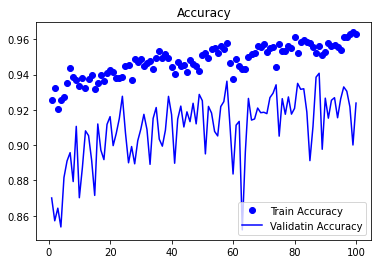

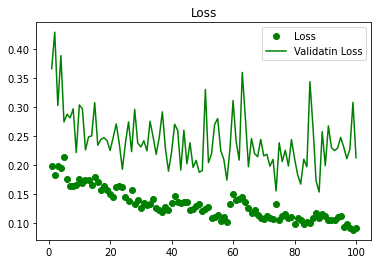

<Figure size 432x288 with 0 Axes>

In [23]:
accuracy = history.history["Accuracy"]
val_accuracy = history.history["val_Accuracy"]
loss = history.history["loss"]
val_loss =  history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  


In [11]:
own_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_unet.h5'

UNet = tf.keras.models.load_model(own_model_path)

## UNet++

In [36]:
import tensorflow as tf
from keras.layers import Flatten
from tensorflow.keras.losses import binary_crossentropy

def dice_coefficient(y_true, y_pred):
    smooth = 1e-15
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred)
    return (2.0 * intersection + smooth) / (union + smooth)

def combined_loss(y_true, y_pred):
    epsilon = 1e-15
    
    # Flatten the tensors
    y_true_flat = tf.keras.layers.Flatten()(y_true)
    y_pred_flat = tf.keras.layers.Flatten()(y_pred)
    
    # Binary Cross-Entropy
    bce = binary_crossentropy(y_true_flat, y_pred_flat)
    
    # Dice Coefficient
    dice = 1 - dice_coefficient(y_true_flat, y_pred_flat)
    
    # Combine the terms
    loss = 0.5 * bce + 0.5 * dice
    
    return tf.reduce_mean(loss)

In [33]:
Nested_UNet_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_unet++.h5'

Nested_UNet.compile(optimizer=Adam(1e-5),
                  loss=combined_loss,
                  metrics=['Accuracy'])


Nested_UNet_history = Nested_UNet.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

Nested_UNet.save(Nested_UNet_model_path)

Epoch 1/100
22/22 [==============================] - 30s 1s/step - loss: 2.1880 - Accuracy: 0.2153 - val_loss: 1.3805 - val_Accuracy: 0.4314
Epoch 2/100
22/22 [==============================] - 25s 1s/step - loss: 0.8653 - Accuracy: 0.5291 - val_loss: 2.1292 - val_Accuracy: 0.3774
Epoch 3/100
22/22 [==============================] - 25s 1s/step - loss: 0.4613 - Accuracy: 0.8145 - val_loss: 2.0971 - val_Accuracy: 0.3276
Epoch 4/100
22/22 [==============================] - 25s 1s/step - loss: 0.3773 - Accuracy: 0.8817 - val_loss: 1.9180 - val_Accuracy: 0.4506
Epoch 5/100
22/22 [==============================] - 25s 1s/step - loss: 0.3409 - Accuracy: 0.8987 - val_loss: 1.4472 - val_Accuracy: 0.5941
Epoch 6/100
22/22 [==============================] - 25s 1s/step - loss: 0.2808 - Accuracy: 0.9199 - val_loss: 0.9591 - val_Accuracy: 0.7061
Epoch 7/100
22/22 [==============================] - 25s 1s/step - loss: 0.3130 - Accuracy: 0.9134 - val_loss: 0.6291 - val_Accuracy: 0.8012
Epoch 8/100
2

Epoch 59/100
22/22 [==============================] - 25s 1s/step - loss: 0.1507 - Accuracy: 0.9514 - val_loss: 0.2847 - val_Accuracy: 0.9112
Epoch 60/100
22/22 [==============================] - 25s 1s/step - loss: 0.1322 - Accuracy: 0.9574 - val_loss: 0.2067 - val_Accuracy: 0.9340
Epoch 61/100
22/22 [==============================] - 25s 1s/step - loss: 0.1473 - Accuracy: 0.9531 - val_loss: 0.2306 - val_Accuracy: 0.9274
Epoch 62/100
22/22 [==============================] - 25s 1s/step - loss: 0.1324 - Accuracy: 0.9536 - val_loss: 0.2114 - val_Accuracy: 0.9336
Epoch 63/100
22/22 [==============================] - 25s 1s/step - loss: 0.1354 - Accuracy: 0.9606 - val_loss: 0.2027 - val_Accuracy: 0.9352
Epoch 64/100
22/22 [==============================] - 25s 1s/step - loss: 0.1217 - Accuracy: 0.9608 - val_loss: 0.2194 - val_Accuracy: 0.9286
Epoch 65/100
22/22 [==============================] - 25s 1s/step - loss: 0.1246 - Accuracy: 0.9605 - val_loss: 0.2025 - val_Accuracy: 0.9311
Epoch 

In [40]:
import os
import json
history_path = os.path.join(os.getenv('HOME'), '/aiffel/AIFEL_Quest/Going_Deeper/Project_05/history_unet++.json')

with open(history_path, 'w') as json_file:
    json.dump(Nested_UNet_history.history, json_file)

<Figure size 432x288 with 0 Axes>

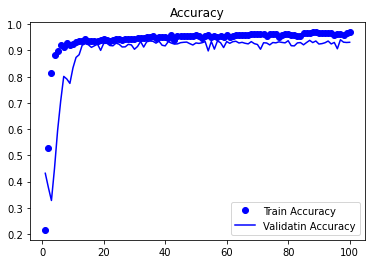

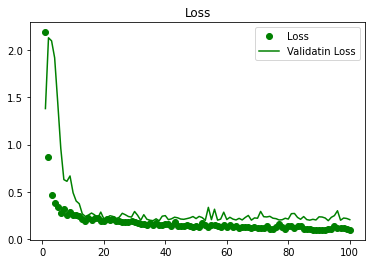

<Figure size 432x288 with 0 Axes>

In [39]:
accuracy = Nested_UNet_history.history["Accuracy"]
val_accuracy = Nested_UNet_history.history["val_Accuracy"]
loss = Nested_UNet_history.history["loss"]
val_loss =  Nested_UNet_history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  

In [38]:
Nested_UNet_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/model/seg_model_unet++.h5'

Nested_UNet = tf.keras.models.load_model(Nested_UNet_model_path, custom_objects={'combined_loss': combined_loss})

## Deep Lab V3+

In [29]:
DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_deepLabV3+.h5'

DLV3_plus.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=['Accuracy'])

DLV3_plus_history = DLV3_plus.fit(
     DL_train_generator,
     validation_data=DL_test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

Epoch 1/100
22/22 [==============================] - 31s 1s/step - loss: 0.3539 - Accuracy: 0.8482 - val_loss: 0.6423 - val_Accuracy: 0.7691
Epoch 2/100
22/22 [==============================] - 22s 984ms/step - loss: 0.2064 - Accuracy: 0.9140 - val_loss: 0.5908 - val_Accuracy: 0.7691
Epoch 3/100
22/22 [==============================] - 22s 969ms/step - loss: 0.2070 - Accuracy: 0.9172 - val_loss: 0.5791 - val_Accuracy: 0.7691
Epoch 4/100
22/22 [==============================] - 21s 959ms/step - loss: 0.1778 - Accuracy: 0.9287 - val_loss: 0.5577 - val_Accuracy: 0.7691
Epoch 5/100
22/22 [==============================] - 21s 964ms/step - loss: 0.1728 - Accuracy: 0.9302 - val_loss: 0.5440 - val_Accuracy: 0.7691
Epoch 6/100
22/22 [==============================] - 22s 969ms/step - loss: 0.1524 - Accuracy: 0.9413 - val_loss: 0.5401 - val_Accuracy: 0.7691
Epoch 7/100
22/22 [==============================] - 21s 963ms/step - loss: 0.1572 - Accuracy: 0.9385 - val_loss: 0.5425 - val_Accuracy: 0.

NameError: name 'own_model' is not defined

In [32]:
DLV3_plus.save(DLV3_model_path)

In [39]:
import os
import json

history_path = os.path.join(os.getenv('HOME'), 'aiffel/AIFEL_Quest/Going_Deeper/Project_05/history_DLV3_plus.json')

with open(history_path, 'w') as json_file:
    json.dump(DLV3_plus_history.history, json_file)

<Figure size 432x288 with 0 Axes>

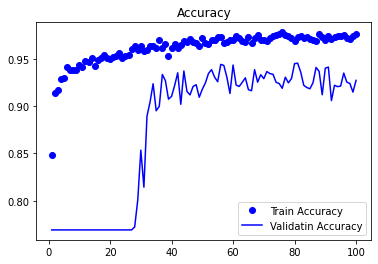

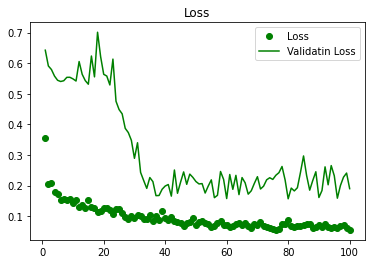

<Figure size 432x288 with 0 Axes>

In [37]:
accuracy = DLV3_plus_history.history["Accuracy"]
val_accuracy = DLV3_plus_history.history["val_Accuracy"]
loss = DLV3_plus_history.history["loss"]
val_loss =  DLV3_plus_history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  

In [28]:
DLV3_plus_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/model/seg_model_deepLabV3+.h5'

DLV3_plus = tf.keras.models.load_model(DLV3_plus_model_path)

# Modified DeepLab V3+

In [19]:
from keras.callbacks import ModelCheckpoint
Modified_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_Modified_deepLabV3+.h5'

Modified_DLV3_plus.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=['Accuracy'])

checkpoint = ModelCheckpoint(
    Modified_DLV3_model_path,          
    monitor='val_accuracy',
    save_best_only=True,       
    mode='max',
    save_weights_only=False    
)

Modified_DLV3_plus_history = Modified_DLV3_plus.fit(
    DL_train_generator,
    validation_data=DL_test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
    callbacks=[checkpoint] 
)

Epoch 1/100
22/22 [==============================] - 58s 2s/step - loss: 0.5147 - Accuracy: 0.8017 - val_loss: 0.6787 - val_Accuracy: 0.7691
Epoch 2/100
22/22 [==============================] - 47s 2s/step - loss: 0.4018 - Accuracy: 0.8612 - val_loss: 0.6635 - val_Accuracy: 0.7691
Epoch 3/100
22/22 [==============================] - 46s 2s/step - loss: 0.4325 - Accuracy: 0.8449 - val_loss: 0.6641 - val_Accuracy: 0.7691
Epoch 4/100
22/22 [==============================] - 47s 2s/step - loss: 0.3973 - Accuracy: 0.8632 - val_loss: 0.6594 - val_Accuracy: 0.7691
Epoch 5/100
22/22 [==============================] - 46s 2s/step - loss: 0.3879 - Accuracy: 0.8647 - val_loss: 0.6489 - val_Accuracy: 0.7691
Epoch 6/100
22/22 [==============================] - 47s 2s/step - loss: 0.3846 - Accuracy: 0.8683 - val_loss: 0.6277 - val_Accuracy: 0.7691
Epoch 7/100
22/22 [==============================] - 46s 2s/step - loss: 0.3907 - Accuracy: 0.8700 - val_loss: 0.6447 - val_Accuracy: 0.7691
Epoch 8/100
2

Epoch 38/100
22/22 [==============================] - 46s 2s/step - loss: 0.3008 - Accuracy: 0.8842 - val_loss: 0.3221 - val_Accuracy: 0.8661
Epoch 39/100
22/22 [==============================] - 47s 2s/step - loss: 0.3016 - Accuracy: 0.8821 - val_loss: 0.3314 - val_Accuracy: 0.8619
Epoch 40/100
22/22 [==============================] - 47s 2s/step - loss: 0.3018 - Accuracy: 0.8827 - val_loss: 0.3303 - val_Accuracy: 0.8650
Epoch 41/100
22/22 [==============================] - 47s 2s/step - loss: 0.3084 - Accuracy: 0.8715 - val_loss: 0.3354 - val_Accuracy: 0.8622
Epoch 42/100
22/22 [==============================] - 46s 2s/step - loss: 0.2960 - Accuracy: 0.8802 - val_loss: 0.3255 - val_Accuracy: 0.8683
Epoch 43/100
22/22 [==============================] - 47s 2s/step - loss: 0.2783 - Accuracy: 0.8953 - val_loss: 0.3208 - val_Accuracy: 0.8681
Epoch 44/100
22/22 [==============================] - 47s 2s/step - loss: 0.2920 - Accuracy: 0.8889 - val_loss: 0.3548 - val_Accuracy: 0.8526
Epoch 

22/22 [==============================] - 47s 2s/step - loss: 0.2884 - Accuracy: 0.8737 - val_loss: 0.3025 - val_Accuracy: 0.8718
Epoch 75/100
22/22 [==============================] - 46s 2s/step - loss: 0.2667 - Accuracy: 0.8947 - val_loss: 0.3022 - val_Accuracy: 0.8721
Epoch 76/100
22/22 [==============================] - 47s 2s/step - loss: 0.2775 - Accuracy: 0.8851 - val_loss: 0.3143 - val_Accuracy: 0.8689
Epoch 77/100
22/22 [==============================] - 46s 2s/step - loss: 0.3176 - Accuracy: 0.8709 - val_loss: 0.3378 - val_Accuracy: 0.8592
Epoch 78/100
22/22 [==============================] - 47s 2s/step - loss: 0.2903 - Accuracy: 0.8826 - val_loss: 0.3067 - val_Accuracy: 0.8724
Epoch 79/100
22/22 [==============================] - 47s 2s/step - loss: 0.2830 - Accuracy: 0.8770 - val_loss: 0.3202 - val_Accuracy: 0.8707
Epoch 80/100
22/22 [==============================] - 47s 2s/step - loss: 0.2760 - Accuracy: 0.8828 - val_loss: 0.3124 - val_Accuracy: 0.8682
Epoch 81/100
22/22 

<Figure size 432x288 with 0 Axes>

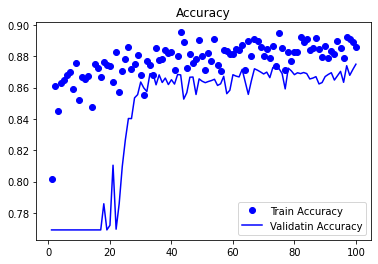

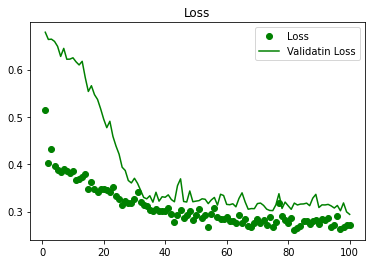

<Figure size 432x288 with 0 Axes>

In [20]:
accuracy = Modified_DLV3_plus_history.history["Accuracy"]
val_accuracy = Modified_DLV3_plus_history.history["val_Accuracy"]
loss = Modified_DLV3_plus_history.history["loss"]
val_loss =  Modified_DLV3_plus_history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  

In [21]:
import os
import json

history_path = os.path.join(os.getenv('HOME'), 'aiffel/AIFEL_Quest/Going_Deeper/Project_05/history_modified_DLV3_plus.json')

with open(history_path, 'w') as json_file:
    json.dump(Modified_DLV3_plus_history.history, json_file)

## Additionaly Modified DeepLab V3+

In [19]:
from keras.callbacks import ModelCheckpoint
Additionaly_Modified_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_Additionaly_Modified_deepLabV3+.h5'

Additionaly_Modified_DLV3_plus.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=['Accuracy'])

checkpoint = ModelCheckpoint(
    Additionaly_Modified_DLV3_model_path,          
    monitor='val_accuracy',
    save_best_only=True,       
    mode='max',
    save_weights_only=False    
)

Additionaly_Modified_DLV3_plus_history = Additionaly_Modified_DLV3_plus.fit(
    DL_train_generator,
    validation_data=DL_test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
    callbacks=[checkpoint] 
)

Epoch 1/100
22/22 [==============================] - 55s 2s/step - loss: 0.8379 - Accuracy: 0.8127 - val_loss: 0.6024 - val_Accuracy: 0.7691
Epoch 2/100
22/22 [==============================] - 44s 2s/step - loss: 0.3578 - Accuracy: 0.8841 - val_loss: 0.5863 - val_Accuracy: 0.7691
Epoch 3/100
22/22 [==============================] - 45s 2s/step - loss: 0.2656 - Accuracy: 0.9057 - val_loss: 0.5568 - val_Accuracy: 0.7691
Epoch 4/100
22/22 [==============================] - 44s 2s/step - loss: 0.2656 - Accuracy: 0.8972 - val_loss: 0.5583 - val_Accuracy: 0.7691
Epoch 5/100
22/22 [==============================] - 44s 2s/step - loss: 0.2426 - Accuracy: 0.9062 - val_loss: 0.5804 - val_Accuracy: 0.7691
Epoch 6/100
22/22 [==============================] - 44s 2s/step - loss: 0.2098 - Accuracy: 0.9244 - val_loss: 0.5575 - val_Accuracy: 0.7691
Epoch 7/100
22/22 [==============================] - 44s 2s/step - loss: 0.2101 - Accuracy: 0.9260 - val_loss: 0.5515 - val_Accuracy: 0.7691
Epoch 8/100
2

Epoch 38/100
22/22 [==============================] - 44s 2s/step - loss: 0.1315 - Accuracy: 0.9423 - val_loss: 0.1775 - val_Accuracy: 0.9272
Epoch 39/100
22/22 [==============================] - 44s 2s/step - loss: 0.1443 - Accuracy: 0.9420 - val_loss: 0.1955 - val_Accuracy: 0.9249
Epoch 40/100
22/22 [==============================] - 44s 2s/step - loss: 0.1246 - Accuracy: 0.9515 - val_loss: 0.1691 - val_Accuracy: 0.9298
Epoch 41/100
22/22 [==============================] - 44s 2s/step - loss: 0.1263 - Accuracy: 0.9436 - val_loss: 0.1647 - val_Accuracy: 0.9334
Epoch 42/100
22/22 [==============================] - 45s 2s/step - loss: 0.1244 - Accuracy: 0.9486 - val_loss: 0.1693 - val_Accuracy: 0.9316
Epoch 43/100
22/22 [==============================] - 44s 2s/step - loss: 0.1070 - Accuracy: 0.9580 - val_loss: 0.1728 - val_Accuracy: 0.9320
Epoch 44/100
22/22 [==============================] - 44s 2s/step - loss: 0.1239 - Accuracy: 0.9504 - val_loss: 0.1880 - val_Accuracy: 0.9265
Epoch 

22/22 [==============================] - 44s 2s/step - loss: 0.0681 - Accuracy: 0.9748 - val_loss: 0.1386 - val_Accuracy: 0.9506
Epoch 75/100
22/22 [==============================] - 44s 2s/step - loss: 0.0955 - Accuracy: 0.9643 - val_loss: 0.1696 - val_Accuracy: 0.9397
Epoch 76/100
22/22 [==============================] - 44s 2s/step - loss: 0.0718 - Accuracy: 0.9713 - val_loss: 0.1732 - val_Accuracy: 0.9349
Epoch 77/100
22/22 [==============================] - 45s 2s/step - loss: 0.0828 - Accuracy: 0.9658 - val_loss: 0.1376 - val_Accuracy: 0.9473
Epoch 78/100
22/22 [==============================] - 45s 2s/step - loss: 0.0725 - Accuracy: 0.9707 - val_loss: 0.1515 - val_Accuracy: 0.9433
Epoch 79/100
22/22 [==============================] - 44s 2s/step - loss: 0.0853 - Accuracy: 0.9664 - val_loss: 0.1456 - val_Accuracy: 0.9442
Epoch 80/100
22/22 [==============================] - 44s 2s/step - loss: 0.1002 - Accuracy: 0.9622 - val_loss: 0.1829 - val_Accuracy: 0.9341
Epoch 81/100
22/22 

In [20]:
Additionaly_Modified_DLV3_plus.save(Additionaly_Modified_DLV3_model_path)

/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


<Figure size 432x288 with 0 Axes>

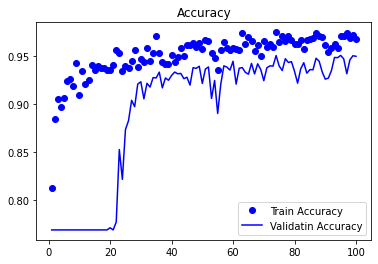

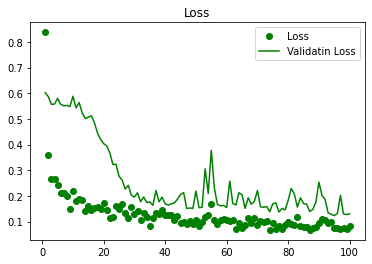

<Figure size 432x288 with 0 Axes>

In [21]:
accuracy = Additionaly_Modified_DLV3_plus_history.history["Accuracy"]
val_accuracy = Additionaly_Modified_DLV3_plus_history.history["val_Accuracy"]
loss = Additionaly_Modified_DLV3_plus_history.history["loss"]
val_loss =  Additionaly_Modified_DLV3_plus_history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  

In [22]:
import os
import json

history_path = os.path.join(os.getenv('HOME'), 'aiffel/AIFEL_Quest/Going_Deeper/Project_05/history_additionaly_modified_DLV3_plus.json')

with open(history_path, 'w') as json_file:
    json.dump(Additionaly_Modified_DLV3_plus_history.history, json_file)

In [ ]:
Additionaly_Modified_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/model/seg_model_Additionaly_Modified_deepLabV3+.h5'

Additionaly_Modified_DLV3_plus = tf.keras.models.load_model(Additionaly_Modified_DLV3_model_path)

## Final Test - Testing Dependancy of Feature map size

In [72]:
from keras.callbacks import ModelCheckpoint
Final_Modified_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_Final_Modified_deepLabV3+.h5'

Final_Modified_DLV3_plus.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=['Accuracy'])

checkpoint = ModelCheckpoint(
    Final_Modified_DLV3_model_path,          
    monitor='val_accuracy',
    save_best_only=True,       
    mode='max',
    save_weights_only=False    
)

Final_Modified_DLV3_plus_history = Final_Modified_DLV3_plus.fit(
    DL_train_generator,
    validation_data=DL_test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
    callbacks=[checkpoint] 
)

Epoch 1/100
22/22 [==============================] - 19s 558ms/step - loss: 0.7545 - Accuracy: 0.8233 - val_loss: 0.5560 - val_Accuracy: 0.7691
Epoch 2/100
22/22 [==============================] - 12s 525ms/step - loss: 0.3291 - Accuracy: 0.9020 - val_loss: 0.5461 - val_Accuracy: 0.7691
Epoch 3/100
22/22 [==============================] - 12s 528ms/step - loss: 0.2643 - Accuracy: 0.9044 - val_loss: 0.5411 - val_Accuracy: 0.7691
Epoch 4/100
22/22 [==============================] - 12s 522ms/step - loss: 0.2544 - Accuracy: 0.9099 - val_loss: 0.5686 - val_Accuracy: 0.7691
Epoch 5/100
22/22 [==============================] - 12s 522ms/step - loss: 0.2263 - Accuracy: 0.9112 - val_loss: 0.5366 - val_Accuracy: 0.7691
Epoch 6/100
22/22 [==============================] - 11s 514ms/step - loss: 0.2097 - Accuracy: 0.9231 - val_loss: 0.5428 - val_Accuracy: 0.7691
Epoch 7/100
22/22 [==============================] - 11s 513ms/step - loss: 0.2076 - Accuracy: 0.9191 - val_loss: 0.5337 - val_Accuracy:

Epoch 37/100
22/22 [==============================] - 12s 519ms/step - loss: 0.1153 - Accuracy: 0.9569 - val_loss: 0.1824 - val_Accuracy: 0.9329
Epoch 38/100
22/22 [==============================] - 11s 517ms/step - loss: 0.1129 - Accuracy: 0.9546 - val_loss: 0.2342 - val_Accuracy: 0.9204
Epoch 39/100
22/22 [==============================] - 11s 517ms/step - loss: 0.1262 - Accuracy: 0.9482 - val_loss: 0.2069 - val_Accuracy: 0.9209
Epoch 40/100
22/22 [==============================] - 12s 519ms/step - loss: 0.1063 - Accuracy: 0.9540 - val_loss: 0.2085 - val_Accuracy: 0.9223
Epoch 41/100
22/22 [==============================] - 11s 519ms/step - loss: 0.1098 - Accuracy: 0.9537 - val_loss: 0.2070 - val_Accuracy: 0.9343
Epoch 42/100
22/22 [==============================] - 11s 518ms/step - loss: 0.1447 - Accuracy: 0.9451 - val_loss: 0.2065 - val_Accuracy: 0.9311
Epoch 43/100
22/22 [==============================] - 11s 518ms/step - loss: 0.1298 - Accuracy: 0.9500 - val_loss: 0.1685 - val_Ac

Epoch 73/100
22/22 [==============================] - 12s 519ms/step - loss: 0.0855 - Accuracy: 0.9662 - val_loss: 0.1955 - val_Accuracy: 0.9353
Epoch 74/100
22/22 [==============================] - 11s 514ms/step - loss: 0.0823 - Accuracy: 0.9676 - val_loss: 0.1738 - val_Accuracy: 0.9405
Epoch 75/100
22/22 [==============================] - 11s 519ms/step - loss: 0.1015 - Accuracy: 0.9602 - val_loss: 0.1557 - val_Accuracy: 0.9424
Epoch 76/100
22/22 [==============================] - 11s 517ms/step - loss: 0.0944 - Accuracy: 0.9627 - val_loss: 0.2155 - val_Accuracy: 0.9288
Epoch 77/100
22/22 [==============================] - 11s 518ms/step - loss: 0.1021 - Accuracy: 0.9613 - val_loss: 0.2494 - val_Accuracy: 0.9314
Epoch 78/100
22/22 [==============================] - 11s 516ms/step - loss: 0.1013 - Accuracy: 0.9594 - val_loss: 0.2388 - val_Accuracy: 0.9303
Epoch 79/100
22/22 [==============================] - 11s 519ms/step - loss: 0.0771 - Accuracy: 0.9694 - val_loss: 0.1995 - val_Ac

In [74]:
Final_Modified_DLV3_plus.save(Final_Modified_DLV3_model_path)

/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


<Figure size 432x288 with 0 Axes>

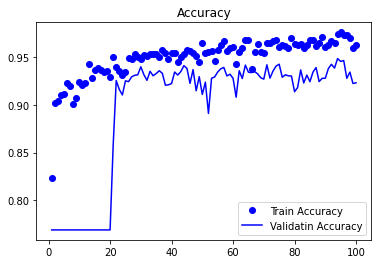

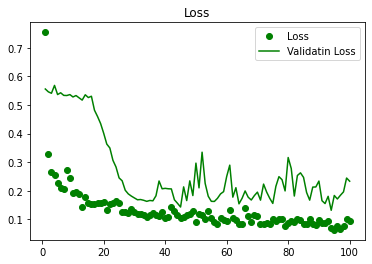

<Figure size 432x288 with 0 Axes>

In [75]:
accuracy = Final_Modified_DLV3_plus_history.history["Accuracy"]
val_accuracy = Final_Modified_DLV3_plus_history.history["val_Accuracy"]
loss = Final_Modified_DLV3_plus_history.history["loss"]
val_loss =  Final_Modified_DLV3_plus_history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  

In [76]:
import os
import json

history_path = os.path.join(os.getenv('HOME'), 'aiffel/AIFEL_Quest/Going_Deeper/Project_05/history_final_modified_DLV3_plus.json')

with open(history_path, 'w') as json_file:
    json.dump(Final_Modified_DLV3_plus_history.history, json_file)

In [ ]:
Final_Modified_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/model/seg_model_Final_Modified_deepLabV3+.h5'

Final_Modified_DLV3_plus = tf.keras.models.load_model(Final_Modified_DLV3_model_path)

## REAL DEEPLABV3+

In [116]:
from keras.callbacks import ModelCheckpoint
REAL_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_REAL_deepLabV3+.h5'

REAL_DLV3Plus.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=['Accuracy'])

checkpoint = ModelCheckpoint(
    REAL_DLV3_model_path,          
    monitor='val_accuracy',
    save_best_only=True,       
    mode='max',
    save_weights_only=False    
)

REAL_DLV3_plus_history = REAL_DLV3Plus.fit(
    DL_train_generator,
    validation_data=DL_test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
    callbacks=[checkpoint] 
)

Epoch 1/100
22/22 [==============================] - 48s 2s/step - loss: 0.4622 - Accuracy: 0.8358 - val_loss: 0.5733 - val_Accuracy: 0.7691
Epoch 2/100
22/22 [==============================] - 41s 2s/step - loss: 0.2824 - Accuracy: 0.8785 - val_loss: 0.5439 - val_Accuracy: 0.7691
Epoch 3/100
22/22 [==============================] - 41s 2s/step - loss: 0.2472 - Accuracy: 0.8983 - val_loss: 0.5414 - val_Accuracy: 0.7691
Epoch 4/100
22/22 [==============================] - 41s 2s/step - loss: 0.2350 - Accuracy: 0.8918 - val_loss: 0.5537 - val_Accuracy: 0.7691
Epoch 5/100
22/22 [==============================] - 41s 2s/step - loss: 0.2022 - Accuracy: 0.9135 - val_loss: 0.5721 - val_Accuracy: 0.7691
Epoch 6/100
22/22 [==============================] - 41s 2s/step - loss: 0.1648 - Accuracy: 0.9314 - val_loss: 0.6573 - val_Accuracy: 0.7691
Epoch 7/100
22/22 [==============================] - 41s 2s/step - loss: 0.1918 - Accuracy: 0.9271 - val_loss: 0.6419 - val_Accuracy: 0.7691
Epoch 8/100
2

Epoch 38/100
22/22 [==============================] - 41s 2s/step - loss: 0.1120 - Accuracy: 0.9559 - val_loss: 0.1510 - val_Accuracy: 0.9454
Epoch 39/100
22/22 [==============================] - 41s 2s/step - loss: 0.1381 - Accuracy: 0.9453 - val_loss: 0.2272 - val_Accuracy: 0.9214
Epoch 40/100
22/22 [==============================] - 41s 2s/step - loss: 0.1286 - Accuracy: 0.9506 - val_loss: 0.1698 - val_Accuracy: 0.9284
Epoch 41/100
22/22 [==============================] - 41s 2s/step - loss: 0.1427 - Accuracy: 0.9422 - val_loss: 0.1594 - val_Accuracy: 0.9367
Epoch 42/100
22/22 [==============================] - 41s 2s/step - loss: 0.1062 - Accuracy: 0.9536 - val_loss: 0.1619 - val_Accuracy: 0.9357
Epoch 43/100
22/22 [==============================] - 41s 2s/step - loss: 0.1137 - Accuracy: 0.9543 - val_loss: 0.1637 - val_Accuracy: 0.9411
Epoch 44/100
22/22 [==============================] - 41s 2s/step - loss: 0.1036 - Accuracy: 0.9564 - val_loss: 0.1572 - val_Accuracy: 0.9420
Epoch 

22/22 [==============================] - 41s 2s/step - loss: 0.0845 - Accuracy: 0.9664 - val_loss: 0.1709 - val_Accuracy: 0.9366
Epoch 75/100
22/22 [==============================] - 41s 2s/step - loss: 0.0888 - Accuracy: 0.9630 - val_loss: 0.1767 - val_Accuracy: 0.9267
Epoch 76/100
22/22 [==============================] - 41s 2s/step - loss: 0.0814 - Accuracy: 0.9680 - val_loss: 0.1566 - val_Accuracy: 0.9391
Epoch 77/100
22/22 [==============================] - 41s 2s/step - loss: 0.0758 - Accuracy: 0.9724 - val_loss: 0.1385 - val_Accuracy: 0.9484
Epoch 78/100
22/22 [==============================] - 41s 2s/step - loss: 0.0830 - Accuracy: 0.9660 - val_loss: 0.1621 - val_Accuracy: 0.9365
Epoch 79/100
22/22 [==============================] - 41s 2s/step - loss: 0.0669 - Accuracy: 0.9737 - val_loss: 0.1640 - val_Accuracy: 0.9376
Epoch 80/100
22/22 [==============================] - 41s 2s/step - loss: 0.0708 - Accuracy: 0.9717 - val_loss: 0.1765 - val_Accuracy: 0.9357
Epoch 81/100
22/22 

In [117]:
REAL_DLV3Plus.save(REAL_DLV3_model_path)

/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


<Figure size 432x288 with 0 Axes>

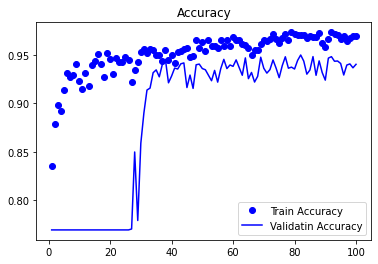

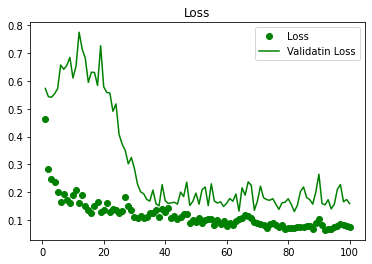

<Figure size 432x288 with 0 Axes>

In [118]:
accuracy = REAL_DLV3_plus_history.history["Accuracy"]
val_accuracy = REAL_DLV3_plus_history.history["val_Accuracy"]
loss = REAL_DLV3_plus_history.history["loss"]
val_loss =  REAL_DLV3_plus_history.history["val_loss"]
                 
epochs = range(1, 101)                           
                            
plt.plot(epochs, accuracy, "bo", label="Train Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validatin Accuracy")
plt.title("Accuracy")
plt.legend()
plt.figure()                            
                            
plt.plot(epochs, loss, "go", label="Loss")
plt.plot(epochs, val_loss, "g", label="Validatin Loss")
plt.title("Loss")
plt.legend()
plt.figure()  

In [119]:
import os
import json

history_path = os.path.join(os.getenv('HOME'), 'aiffel/AIFEL_Quest/Going_Deeper/Project_05/history_REAL_DLV3_plus.json')

with open(history_path, 'w') as json_file:
    json.dump(REAL_DLV3_plus_history.history, json_file)

In [120]:
REAL_DLV3_model_path = os.getenv('HOME')+'/aiffel/AIFEL_Quest/Going_Deeper/Project_05/seg_model_REAL_deepLabV3+.h5'

REAL_DLV3Plus = tf.keras.models.load_model(REAL_DLV3_model_path)

# 3. Check Result

In [121]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    
    processed = preproc(**data)
    
    # Retrieve Predicted Image
    # Input pixel value -> 0~1
    # If Output pixel value > threshold, convert the output value to real scale
    output = model(np.expand_dims(processed["image"]/255, axis=0))
    output = (output[0].numpy()>0.5).astype(np.uint8).squeeze(-1)*255 
    prediction = output/255
    output = Image.fromarray(output)
    
    # Resize output and Convert Format
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    
    backgroud = Image.fromarray(origin_img).convert('RGBA')
    output = Image.blend(backgroud, output, alpha=0.5)
    output.show()
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        
        
        target = (label_processed == 7).astype(np.uint8)*1   

        return output, prediction, target
    
    else:
        return output, prediction, _

In [122]:
def calculate_iou_score(target, prediction):
    add = target + prediction
    
    count_1 = 0
    count_2 = 0
    for row in add:
        for column in row:
            if column == 1:
                count_1 += 1
            elif column == 2:
                count_2 += 1
    
    intersection = count_2
    union = count_2 + count_1
    iou_score = intersection / union * 100
    return iou_score

## UNet model Inference Image 

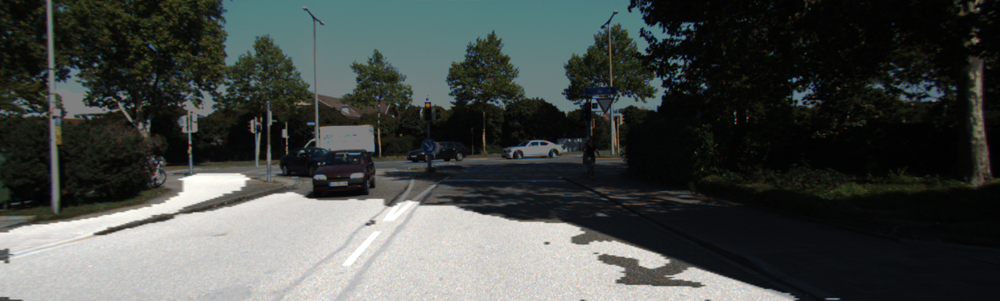

In [62]:
i = 7
output, prediction, target = get_output(
     own_model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

In [63]:
calculate_iou_score(target, prediction)

IoU : 68.222621


68.2226211849192

## UNet++ model Inference Image 

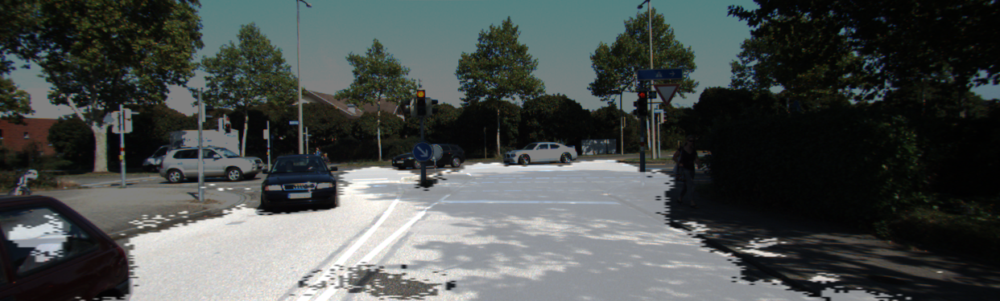

In [39]:
i = 8
output, prediction, target = get_output(
     Nested_UNet, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

In [40]:
calculate_iou_score(target, prediction)

82.49757360077645

## DeepLabV3+ model Inference Image 

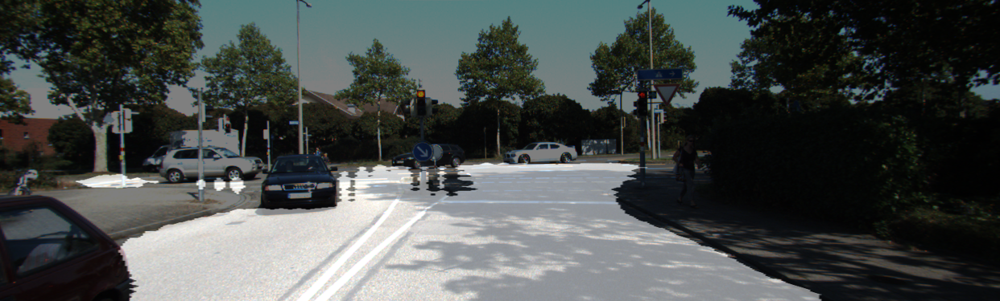

In [41]:
i = 8
output, prediction, target = get_output(
     DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

In [42]:
calculate_iou_score(target, prediction)

91.92645539097485

## Modified DeepLabV3+ model Inference Image 

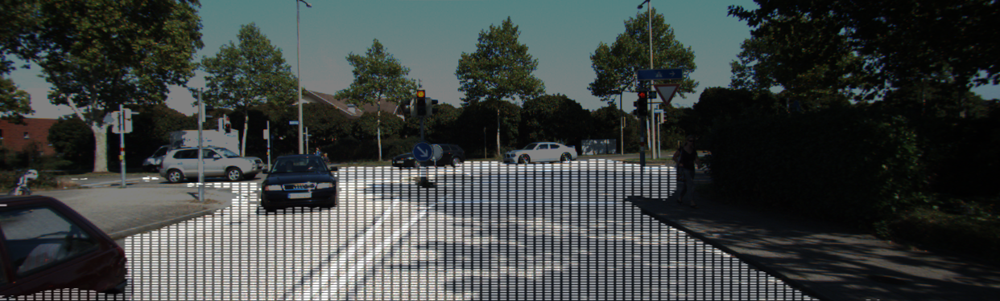

In [43]:
i = 8
output, prediction, target = get_output(
     Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

#### ??????? 왜 격자가 보이지?????  
1. upsampling에서 문제 가능성  -> modified deep lab 모델에서는 con2d Transpose만 사용했음  
    -  그렇다고 치기에는 격자 무늬를 제외하고 segmentaion 너무 잘 됨  
    - https://distill.pub/2016/deconv-checkerboard/?fbclid=IwAR3w34RgZAHXLFTOVejriI8tvUneECpv-uwwKqcIBnZ7BKpCZEI-GaMPTCA   
**위 사이트 정리**  
-> Decoder과정에서 Conv2DTranspose의 kernel size와 stride를 잘못 설정하면 이러한 경우 발생  
-> 엔지니어가 위 설정값을 잘못 설정하면 필연적으로 생길 수 밖에 없음. *대안책* 필요
-> using nearest-neighbor interpolation or bilinear interpolation   
-> 위 사이트에 의하면 "We’ve had our best results with nearest-neighbor interpolation"   
  
2. skip connection 문제 -> 최종 encoder feature map을 high resolution 가져간 것 이외에는 변화점 없음  

## Additionaly_Modified DeepLabV3+ model Inference Image

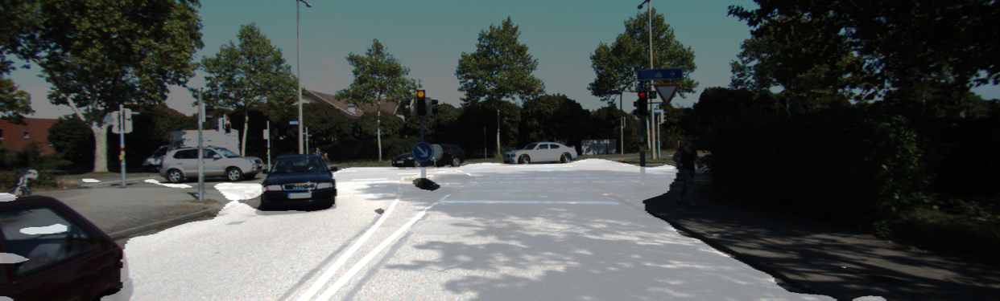

In [78]:
i = 8
output, prediction, target = get_output(
     Additionaly_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

In [26]:
calculate_iou_score(target, prediction) 

89.78906604045648

-> IOU가 낮아도 decoder부분을 수정한 것이 훨씬 깔끔하게 masking이 이루어진다.

## Final_Modified_DLV3_model -> Check Feature map dependancy

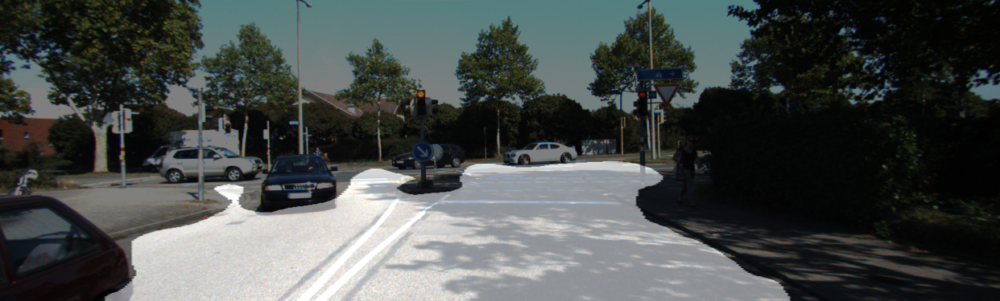

In [79]:
i = 8
output, prediction, target = get_output(
     Final_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

In [80]:
calculate_iou_score(target, prediction) 

90.1117522146672

## REAL DLV3+

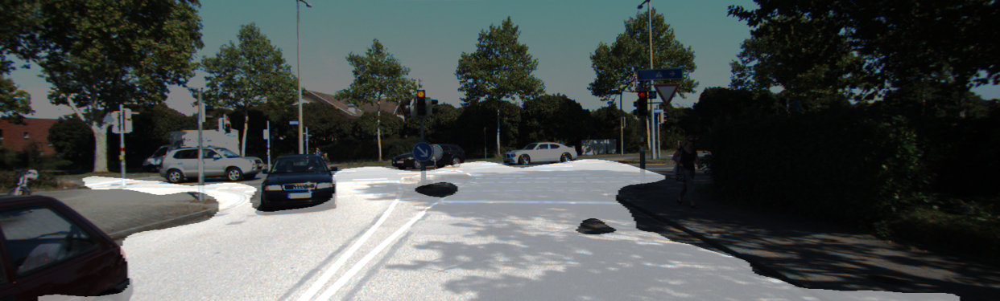

In [123]:
i = 8
output, prediction, target = get_output(
     REAL_DLV3Plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

In [124]:
calculate_iou_score(target, prediction) 

88.44999794483948

## IOU compare

In [83]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    
    processed = preproc(**data)
    
    # Retrieve Predicted Image
    # Input pixel value -> 0~1
    # If Output pixel value > threshold, convert the output value to real scale
    output = model(np.expand_dims(processed["image"]/255, axis=0))
    output = (output[0].numpy()>0.5).astype(np.uint8).squeeze(-1)*255 
    prediction = output/255
    output = Image.fromarray(output)
    
    # Resize output and Convert Format
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    
    backgroud = Image.fromarray(origin_img).convert('RGBA')
    output = Image.blend(backgroud, output, alpha=0.5)
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        
        
        target = (label_processed == 7).astype(np.uint8)*1   

        return output, prediction, target
    
    else:
        return output, prediction, _

In [82]:
model_list = []
model_list.append(Final_Modified_DLV3_plus)
model_list.append(Additionaly_Modified_DLV3_plus)
model_list.append(DLV3_plus)

model_name_list = ["Final_Modified_DLV3_plus", "Additionaly_Modified_DLV3_plus", "DLV3_plus"]

In [41]:
for i in range(20):
    print(f"======{i} 번째 사진 IOU 값======")
    for j in range(3):
        if j == 2:
            output, prediction, target = get_output(
                 model_list[j], 
                 DLtest_preproc,
                 image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                 output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                 label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
            )
        else: 
            output, prediction, target = get_output(
                 model_list[j], 
                 test_preproc,
                 image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                 output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                 label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
            )
        IOU = calculate_iou_score(target, prediction)
        print(f"{model_name_list[j]} IOU Score: {IOU}")

======0 번째 사진 IOU 값======
UNet IOU Score: 16.91919191919192
UNet++ IOU Score: 93.52323360916614
DeepLabV3+ IOU Score: 96.68419083623762
======1 번째 사진 IOU 값======
UNet IOU Score: 41.96408941004031
UNet++ IOU Score: 92.40325252221051
DeepLabV3+ IOU Score: 95.80840642001122
======2 번째 사진 IOU 값======
UNet IOU Score: 58.40873634945398
UNet++ IOU Score: 80.56941590842384
DeepLabV3+ IOU Score: 91.66976648067782
======3 번째 사진 IOU 값======
UNet IOU Score: 57.12116368286445
UNet++ IOU Score: 77.49484443647448
DeepLabV3+ IOU Score: 82.44607516121859
======4 번째 사진 IOU 값======
UNet IOU Score: 56.029585164540684
UNet++ IOU Score: 82.5925925925926
DeepLabV3+ IOU Score: 90.95139419056967
======5 번째 사진 IOU 값======
UNet IOU Score: 64.70318061775176
UNet++ IOU Score: 82.94142201196605
DeepLabV3+ IOU Score: 93.6662754461937
======6 번째 사진 IOU 값======
UNet IOU Score: 9.676714722586283
UNet++ IOU Score: 86.52950310559007
DeepLabV3+ IOU Score: 89.68652667537425
======7 번째 사진 IOU 값======
UNet IOU Score: 68.2226

In [34]:
for i in range(20):
    print(f"======{i} 번째 사진 IOU 값======")
    for j in range(2):
        
        output, prediction, target = get_output(
                 model_list[j], 
                 DLtest_preproc,
                 image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                 output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                 label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
         
        )
        IOU = calculate_iou_score(target, prediction)
        print(f"{model_name_list[j]} IOU Score: {IOU}")

======0 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 85.7955110236377
DLV3_plus IOU Score: 96.68419083623762
======1 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 95.6087243373307
DLV3_plus IOU Score: 95.80840642001122
======2 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 85.82592516022328
DLV3_plus IOU Score: 91.66976648067782
======3 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 81.98676364589477
DLV3_plus IOU Score: 82.44607516121859
======4 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 87.30289037113049
DLV3_plus IOU Score: 90.95139419056967
======5 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 90.01421198294562
DLV3_plus IOU Score: 93.6662754461937
======6 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 81.34288272157565
DLV3_plus IOU Score: 89.68652667537425
======7 번째 사진 IOU 값======
Additionaly_Modified_DLV3_plus IOU Score: 89.20521945432978
DLV3_plus IOU Score: 94.28953910881623
===

In [84]:
for i in range(20):
    print(f"======{i} 번째 사진 IOU 값======")
    for j in range(3):
        
        output, prediction, target = get_output(
                 model_list[j], 
                 DLtest_preproc,
                 image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                 output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                 label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
         
        )
        IOU = calculate_iou_score(target, prediction)
        print(f"{model_name_list[j]} IOU Score: {IOU}")

======0 번째 사진 IOU 값======
Final_Modified_DLV3_plus IOU Score: 80.59707457437455
Additionaly_Modified_DLV3_plus IOU Score: 85.7955110236377
DLV3_plus IOU Score: 96.68419083623762
======1 번째 사진 IOU 값======
Final_Modified_DLV3_plus IOU Score: 88.54082535287104
Additionaly_Modified_DLV3_plus IOU Score: 95.6087243373307
DLV3_plus IOU Score: 95.80840642001122
======2 번째 사진 IOU 값======
Final_Modified_DLV3_plus IOU Score: 41.77917632300725
Additionaly_Modified_DLV3_plus IOU Score: 85.82592516022328
DLV3_plus IOU Score: 91.66976648067782
======3 번째 사진 IOU 값======
Final_Modified_DLV3_plus IOU Score: 82.856389291837
Additionaly_Modified_DLV3_plus IOU Score: 81.98676364589477
DLV3_plus IOU Score: 82.44607516121859
======4 번째 사진 IOU 값======
Final_Modified_DLV3_plus IOU Score: 88.2291774981803
Additionaly_Modified_DLV3_plus IOU Score: 87.30289037113049
DLV3_plus IOU Score: 90.95139419056967
======5 번째 사진 IOU 값======
Final_Modified_DLV3_plus IOU Score: 90.94385803885574
Additionaly_Modified_DLV3_plus

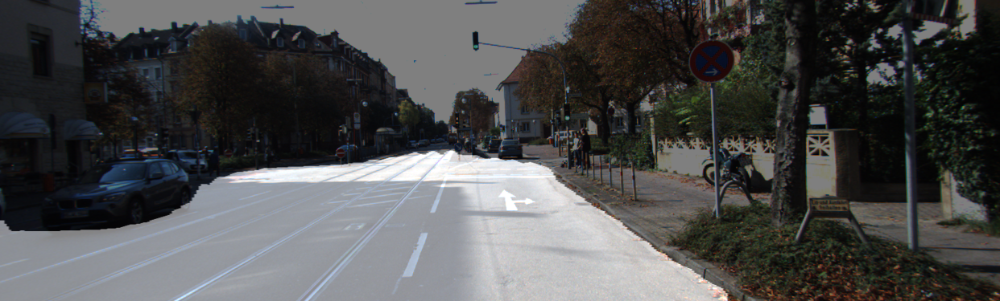

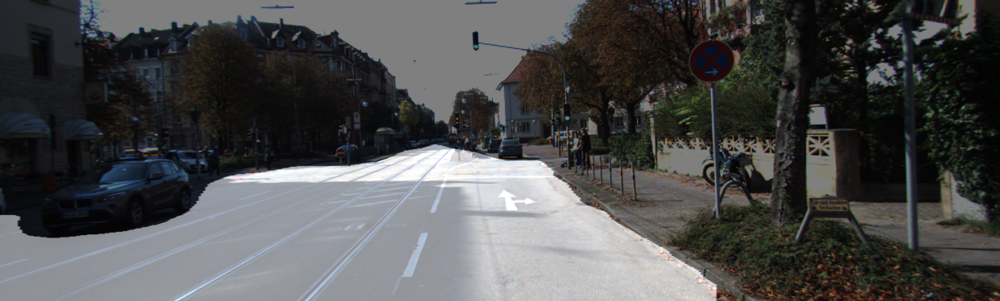

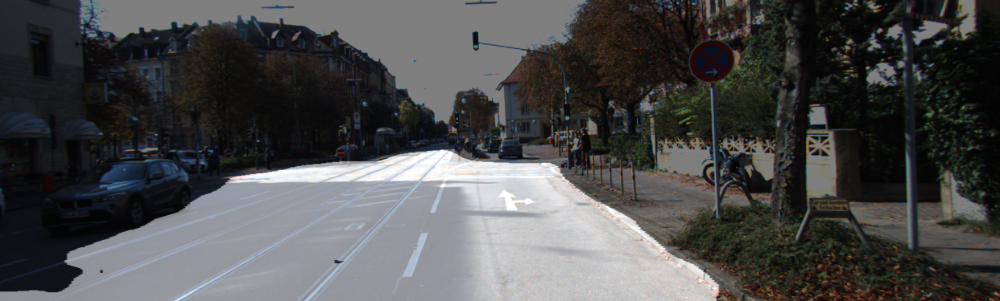

In [87]:
i = 1
output, prediction, target = get_output(
     DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Additionaly_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Final_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

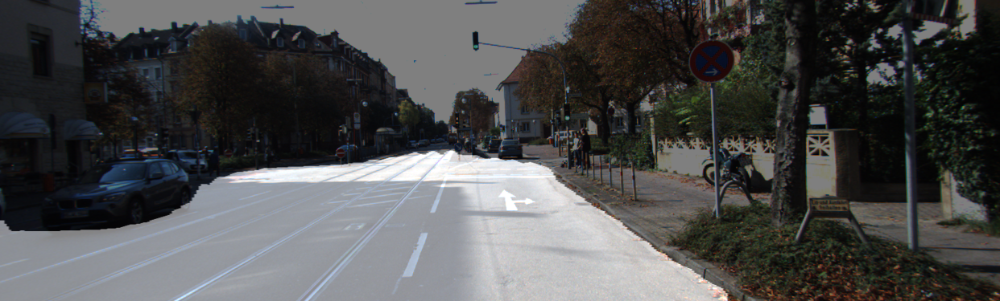

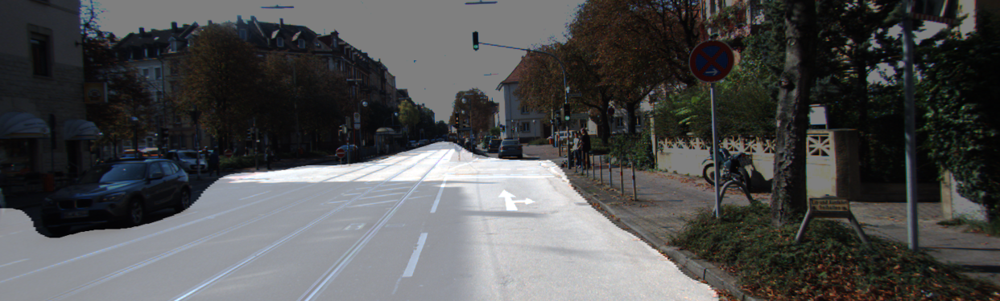

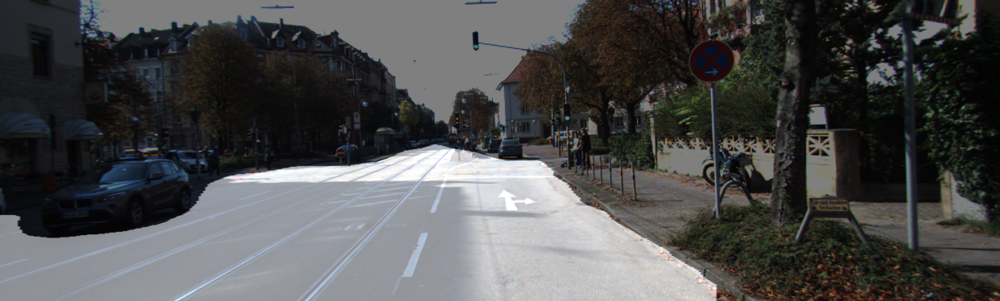

In [125]:
i = 1
output, prediction, target = get_output(
     DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     REAL_DLV3Plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Additionaly_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

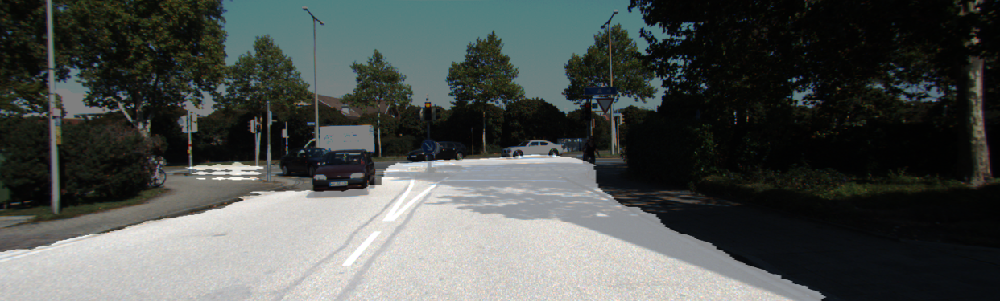

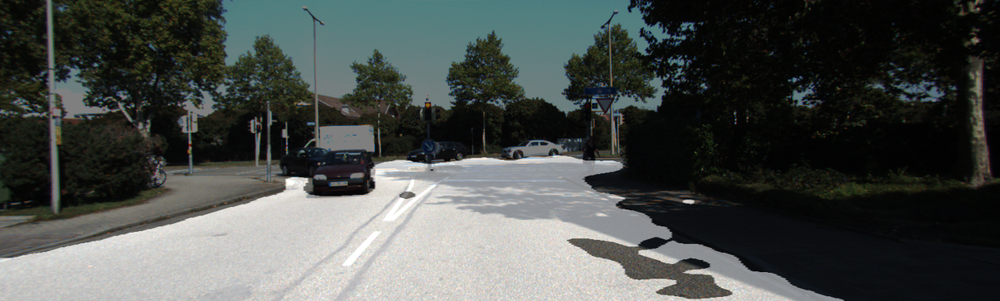

In [38]:
i = 7
output, prediction, target = get_output(
     DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Additionaly_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

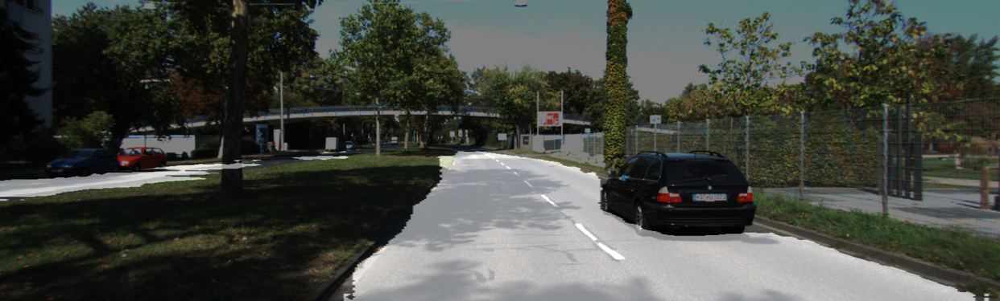

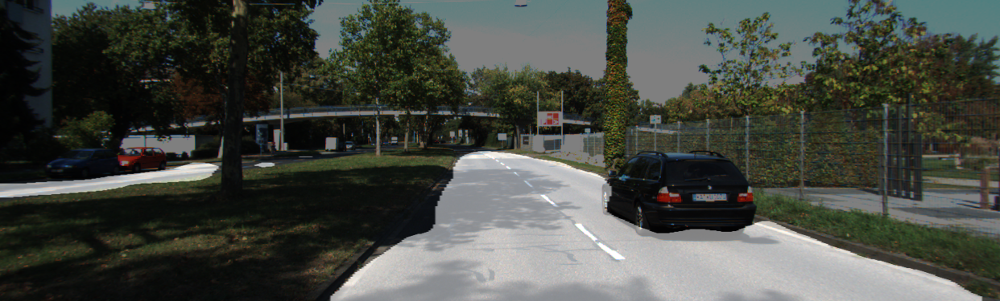

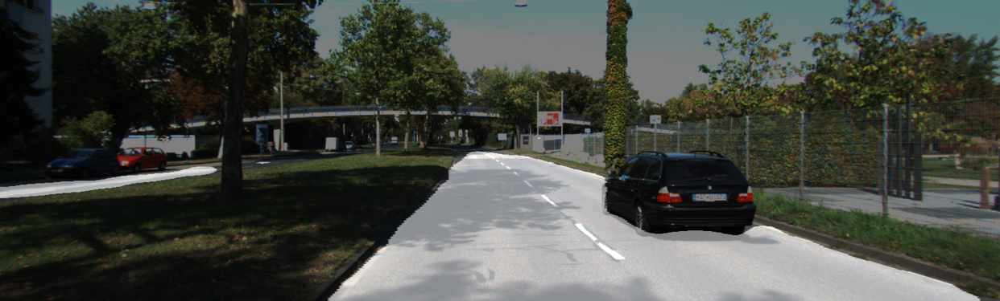

In [126]:
i = 19
output, prediction, target = get_output(
     DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     REAL_DLV3Plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Additionaly_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

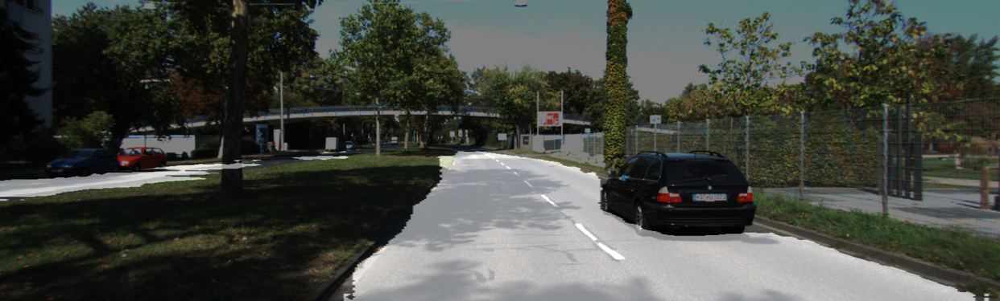

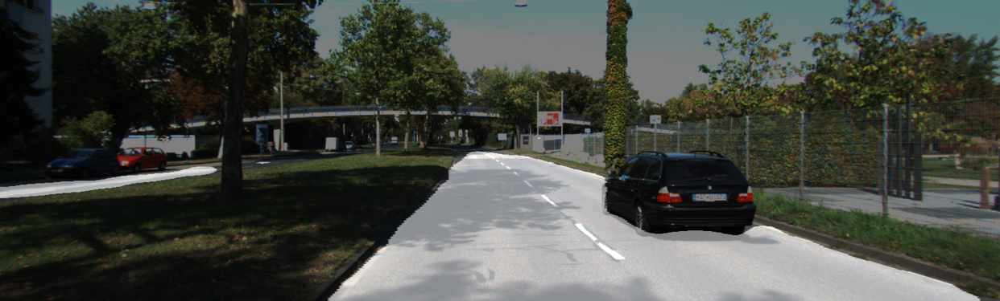

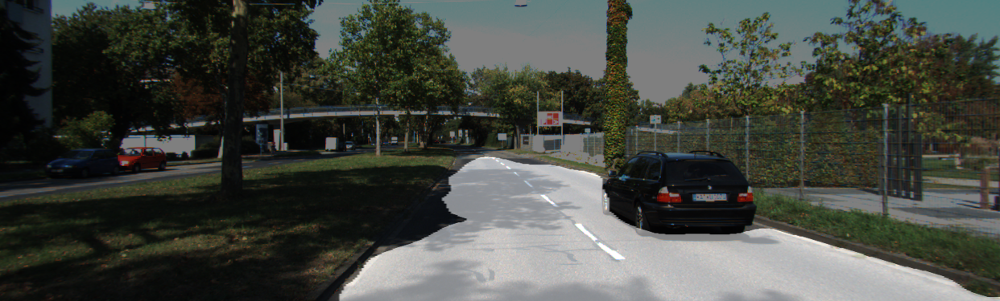

In [88]:
i = 19
output, prediction, target = get_output(
     DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Additionaly_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

output, prediction, target = get_output(
     Final_Modified_DLV3_plus, 
     DLtest_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

-> Additionaly_Modified_DLV3_plus
interpolation='bilinear' 만 사용하였다. 결과적으로 masking가장자리가 부드러운 곡선으로 이루어진다.    

-> DLV3_plus
interpolation='bilinear' 과 더불어 conv2DTranspose도 사용했다. 그래서인지 굴곡이 보인다.  

-> Final_plus
final feature map은 클수록 좋다!  

# Wrap up
## IOU 성능비교  
   UNet < UNet++ < DeepLabV3+    
     
## UNet 과 UNet history 그래프 비교  
 1. UNet history 그래프 추이를 보면 Validation accuray들이 spark부분이 관측된다.   
 2. Upsampling 및 Skip Connection이 feature maps들을 더 잘 반영해주어 object detection에 유리한 feature map을 만들어준다고 생각할 수 있다.  
 
## Deep Lab V3+ -> 가장 좋은 성능
 1. Feature map을 크게 가져가는 것 + sparse convolution 이 object detection에 도움을 준다.      
 2. 그림 8번을 보면 더 정교한 object detection을 하는 것을 볼 수 있다.  
 3. 파라미터수와 연산량을 비슷하게 가져가면서 더 좋은 성능을 낼 수 있다.  
 4. (개선점)  Validation accuray들이 spark부분이 관측된다 -> Unet++ 처럼 디코더 과정을 좀 더 정교하게 구현하면 개선될 여지가 많고 성능을 높일 수 있다.  
 
## 프로젝트 이후 개선한 점  
1. Decoder 정교한 구조를 구성하였다.  
    - Upsampling으로 conv2DTranspose만 쓰면 grid가 decoder과정에서 발생한다.  
    - Upsampling에서 upsampling2D만 진행하면 부드러운 mask가 생성된다.  
    - 순수 DeepLABv3+보다 UNET을 일부 차용한 decoder구조가 더 좋다. (middleflow에서 feature map을 추출하는 것이 더 좋음)  
     ex) REALDEEPLAB < 다른 Deeplab model  

2. Encoder Feature map은 클수록 좋다.  
    - Final model이 additionaly modified model보다 feature map을 작게 가져갔는데 IOU 성능이 떨어졌다.   